In [1]:
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
import os
from dotenv import load_dotenv

In [2]:
load_dotenv()
folder_path = os.getenv('DATASETS_FOLDER_PATH')
filename = 'stock_returns_5yr.csv'
stock_returns_file_path = os.path.join(folder_path, filename)

In [3]:
data = pd.read_csv(stock_returns_file_path)

In [4]:
data.head()

,date,close,Name,returns,log_returns
0,2013-02-12,14.27,AAL,-0.013140,-0.013227
1,2013-02-13,14.66,AAL,0.027330,0.026963
2,2013-02-14,13.99,AAL,-0.045703,-0.046780
3,2013-02-15,14.50,AAL,0.036455,0.035806
4,2013-02-19,14.26,AAL,-0.016552,-0.016690


In [5]:
len(data)

618030

In [6]:
pivot_df = data.pivot(index='date', columns='Name', values='log_returns')


In [7]:
pivot_df.head()

Name,A,AAL,AAP,AAPL,ABBV,ABC,ABT,ACN,ADBE,ADI,...,XL,XLNX,XOM,XRAY,XRX,XYL,YUM,ZBH,ZION,ZTS
date,,,,,,,,,,,,,,,,,,,,,
2013-02-12,0.000448,-0.013227,0.002675,-0.025386,-0.012067,0.004268,0.001167,0.004097,0.006449,0.004115,...,0.003526,0.003198,0.002037,0.000700,-0.003762,0.017687,0.003094,-0.002780,0.011499,0.014329
2013-02-13,0.002909,0.026963,0.004696,-0.001905,-0.004244,-0.006838,0.004654,0.002586,-0.002059,-0.000216,...,0.000352,0.005837,0.002371,0.004887,0.005013,0.011030,-0.005265,0.007396,0.010156,-0.005647
2013-02-14,-0.003806,-0.046780,-0.001648,-0.000900,0.036195,0.002783,0.006940,-0.005863,-0.005167,0.006035,...,-0.007062,0.016789,-0.001693,-0.003954,0.003743,0.007404,-0.008106,0.004464,-0.004456,-0.008381
2013-02-15,-0.053681,0.035806,0.002027,-0.013876,0.027244,-0.003641,0.010891,0.013986,0.000647,-0.007874,...,0.015820,-0.008360,-0.001809,-0.002567,-0.007500,-0.006696,0.001564,-0.005780,-0.011844,0.021116
2013-02-19,0.017828,-0.016690,0.021539,-0.000370,0.016102,0.013217,-0.007439,0.016582,0.009275,0.017922,...,0.004524,0.026406,0.010806,0.015993,0.003757,0.016831,0.017965,0.002763,0.014277,-0.004129


In [8]:
type(pivot_df)

pandas.core.frame.DataFrame

In [9]:
correlation_matrix = pivot_df.corr()
print(correlation_matrix)

Name         A       AAL       AAP      AAPL      ABBV       ABC       ABT  \
Name                                                                         
A     1.000000  0.281502  0.177246  0.265804  0.340767  0.220227  0.443638   
AAL   0.281502  1.000000  0.189710  0.211550  0.226149  0.231353  0.291997   
AAP   0.177246  0.189710  1.000000  0.127678  0.211529  0.163506  0.275011   
AAPL  0.265804  0.211550  0.127678  1.000000  0.183094  0.140602  0.266050   
ABBV  0.340767  0.226149  0.211529  0.183094  1.000000  0.337410  0.433047   
...        ...       ...       ...       ...       ...       ...       ...   
XYL   0.422379  0.284643  0.236004  0.262585  0.293805  0.199669  0.351211   
YUM   0.266806  0.236913  0.195091  0.237771  0.182720  0.158882  0.259320   
ZBH   0.370876  0.251802  0.214250  0.272430  0.371298  0.246239  0.481659   
ZION  0.386241  0.329088  0.270329  0.258506  0.272773  0.246117  0.368508   
ZTS   0.309875  0.250834  0.162897  0.237710  0.375836  0.275358

In [10]:
# plt.figure(figsize=(100, 100))
# sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=.5)
# plt.show()

In [11]:
import networkx as nx

In [12]:
G = nx.Graph()

G.add_nodes_from(correlation_matrix.index)

for i in range(len(correlation_matrix.index)):
    for j in range(i+1, len(correlation_matrix.index)):
        company1 = correlation_matrix.index[i]
        company2 = correlation_matrix.index[j]
        correlation_coefficient = correlation_matrix.loc[company1, company2]
        G.add_edge(company1, company2, weight=correlation_coefficient)


In [13]:
G.number_of_edges()

127260

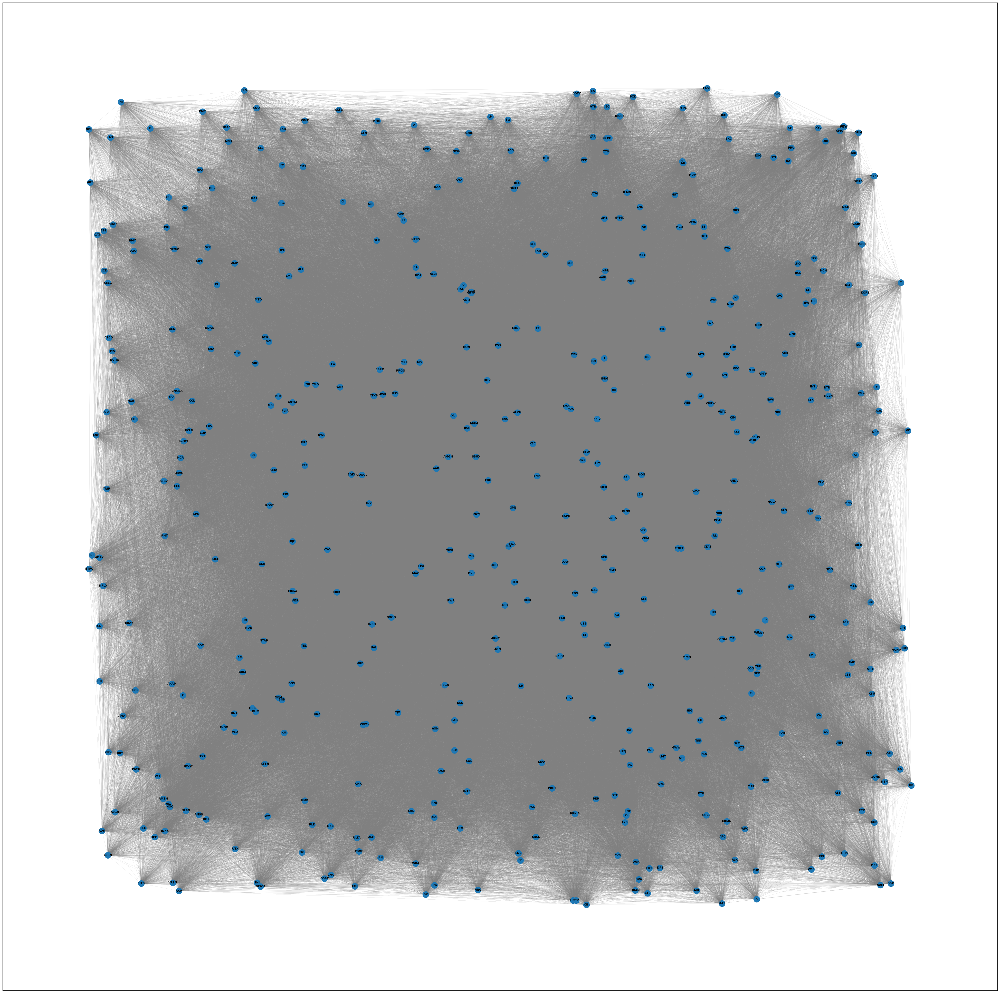

In [14]:
plt.figure(figsize=(50, 50))

pos = nx.random_layout(G)
nx.draw_networkx(G, pos, with_labels=True, font_size=8, font_color="black", font_weight="bold", edge_color="gray", width=0.1)

# Show the plot
plt.show()

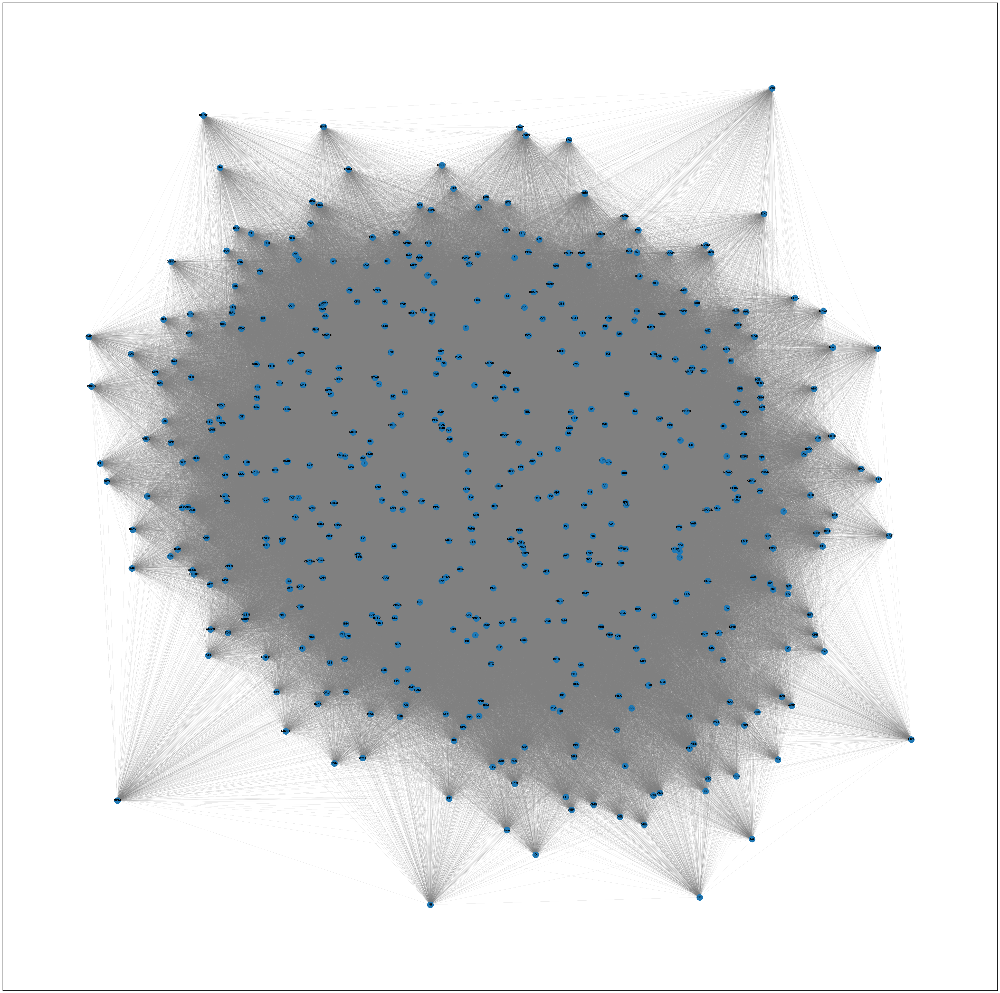

In [15]:
plt.figure(figsize=(50, 50))

pos = nx.spring_layout(G)
nx.draw_networkx(G, pos, with_labels=True, font_size=8, font_color="black", font_weight="bold", edge_color="gray", width=0.1)

# Show the plot
plt.show()

In [16]:
# Print nodes and their attributes
print("Nodes:")
for node_id, attributes in G.nodes(data=True):
    print(f"Node {node_id}: {attributes}")

# Print edges and their attributes
print("\nEdges:")
for edge in G.edges(data=True):
    print(f"Edge {edge[:2]}: {edge[2]}")

Nodes:
Node A: {}
Node AAL: {}
Node AAP: {}
Node AAPL: {}
Node ABBV: {}
Node ABC: {}
Node ABT: {}
Node ACN: {}
Node ADBE: {}
Node ADI: {}
Node ADM: {}
Node ADP: {}
Node ADS: {}
Node ADSK: {}
Node AEE: {}
Node AEP: {}
Node AES: {}
Node AET: {}
Node AFL: {}
Node AGN: {}
Node AIG: {}
Node AIV: {}
Node AIZ: {}
Node AJG: {}
Node AKAM: {}
Node ALB: {}
Node ALGN: {}
Node ALK: {}
Node ALL: {}
Node ALLE: {}
Node ALXN: {}
Node AMAT: {}
Node AMD: {}
Node AME: {}
Node AMG: {}
Node AMGN: {}
Node AMP: {}
Node AMT: {}
Node AMZN: {}
Node ANDV: {}
Node ANSS: {}
Node ANTM: {}
Node AON: {}
Node AOS: {}
Node APA: {}
Node APC: {}
Node APD: {}
Node APH: {}
Node APTV: {}
Node ARE: {}
Node ARNC: {}
Node ATVI: {}
Node AVB: {}
Node AVGO: {}
Node AVY: {}
Node AWK: {}
Node AXP: {}
Node AYI: {}
Node AZO: {}
Node BA: {}
Node BAC: {}
Node BAX: {}
Node BBT: {}
Node BBY: {}
Node BDX: {}
Node BEN: {}
Node BF.B: {}
Node BHF: {}
Node BHGE: {}
Node BIIB: {}
Node BK: {}
Node BLK: {}
Node BLL: {}
Node BMY: {}
Node BRK.B: {}

In [17]:
load_dotenv()
sp500_csv_file_path = os.getenv('SP500_CSV_FILE_PATH')
sp500_df = pd.read_csv(sp500_csv_file_path)

In [18]:
sp500_df.set_index('Symbol', inplace=True)
print(sp500_df)

                       Name                  Sector
Symbol                                             
MMM                      3M             Industrials
AOS             A. O. Smith             Industrials
ABT     Abbott Laboratories             Health Care
ABBV                 AbbVie             Health Care
ABMD                Abiomed             Health Care
...                     ...                     ...
YUM             Yum! Brands  Consumer Discretionary
ZBRA     Zebra Technologies  Information Technology
ZBH           Zimmer Biomet             Health Care
ZION          Zions Bancorp              Financials
ZTS                  Zoetis             Health Care

[505 rows x 2 columns]


In [19]:
symbol_attributes = sp500_df[['Name', 'Sector']].to_dict(orient='index')

In [20]:
symbol_attributes

{'MMM': {'Name': '3M', 'Sector': 'Industrials'},
 'AOS': {'Name': 'A. O. Smith', 'Sector': 'Industrials'},
 'ABT': {'Name': 'Abbott Laboratories', 'Sector': 'Health Care'},
 'ABBV': {'Name': 'AbbVie', 'Sector': 'Health Care'},
 'ABMD': {'Name': 'Abiomed', 'Sector': 'Health Care'},
 'ACN': {'Name': 'Accenture', 'Sector': 'Information Technology'},
 'ATVI': {'Name': 'Activision Blizzard', 'Sector': 'Communication Services'},
 'ADM': {'Name': 'ADM', 'Sector': 'Consumer Staples'},
 'ADBE': {'Name': 'Adobe', 'Sector': 'Information Technology'},
 'AAP': {'Name': 'Advance Auto Parts', 'Sector': 'Consumer Discretionary'},
 'AMD': {'Name': 'Advanced Micro Devices', 'Sector': 'Information Technology'},
 'AES': {'Name': 'AES Corp', 'Sector': 'Utilities'},
 'AFL': {'Name': 'Aflac', 'Sector': 'Financials'},
 'A': {'Name': 'Agilent Technologies', 'Sector': 'Health Care'},
 'APD': {'Name': 'Air Products & Chemicals', 'Sector': 'Materials'},
 'AKAM': {'Name': 'Akamai Technologies', 'Sector': 'Informat

In [21]:
nx.set_node_attributes(G, symbol_attributes)

In [22]:
print("Nodes:")
for node_id, attributes in G.nodes(data=True):
    print(f"Node {node_id}: {attributes}")


Nodes:
Node A: {'Name': 'Agilent Technologies', 'Sector': 'Health Care'}
Node AAL: {'Name': 'American Airlines Group', 'Sector': 'Industrials'}
Node AAP: {'Name': 'Advance Auto Parts', 'Sector': 'Consumer Discretionary'}
Node AAPL: {'Name': 'Apple', 'Sector': 'Information Technology'}
Node ABBV: {'Name': 'AbbVie', 'Sector': 'Health Care'}
Node ABC: {'Name': 'AmerisourceBergen', 'Sector': 'Health Care'}
Node ABT: {'Name': 'Abbott Laboratories', 'Sector': 'Health Care'}
Node ACN: {'Name': 'Accenture', 'Sector': 'Information Technology'}
Node ADBE: {'Name': 'Adobe', 'Sector': 'Information Technology'}
Node ADI: {'Name': 'Analog Devices', 'Sector': 'Information Technology'}
Node ADM: {'Name': 'ADM', 'Sector': 'Consumer Staples'}
Node ADP: {'Name': 'Automatic Data Processing', 'Sector': 'Information Technology'}
Node ADS: {}
Node ADSK: {'Name': 'Autodesk', 'Sector': 'Information Technology'}
Node AEE: {'Name': 'Ameren Corp', 'Sector': 'Utilities'}
Node AEP: {'Name': 'American Electric Power

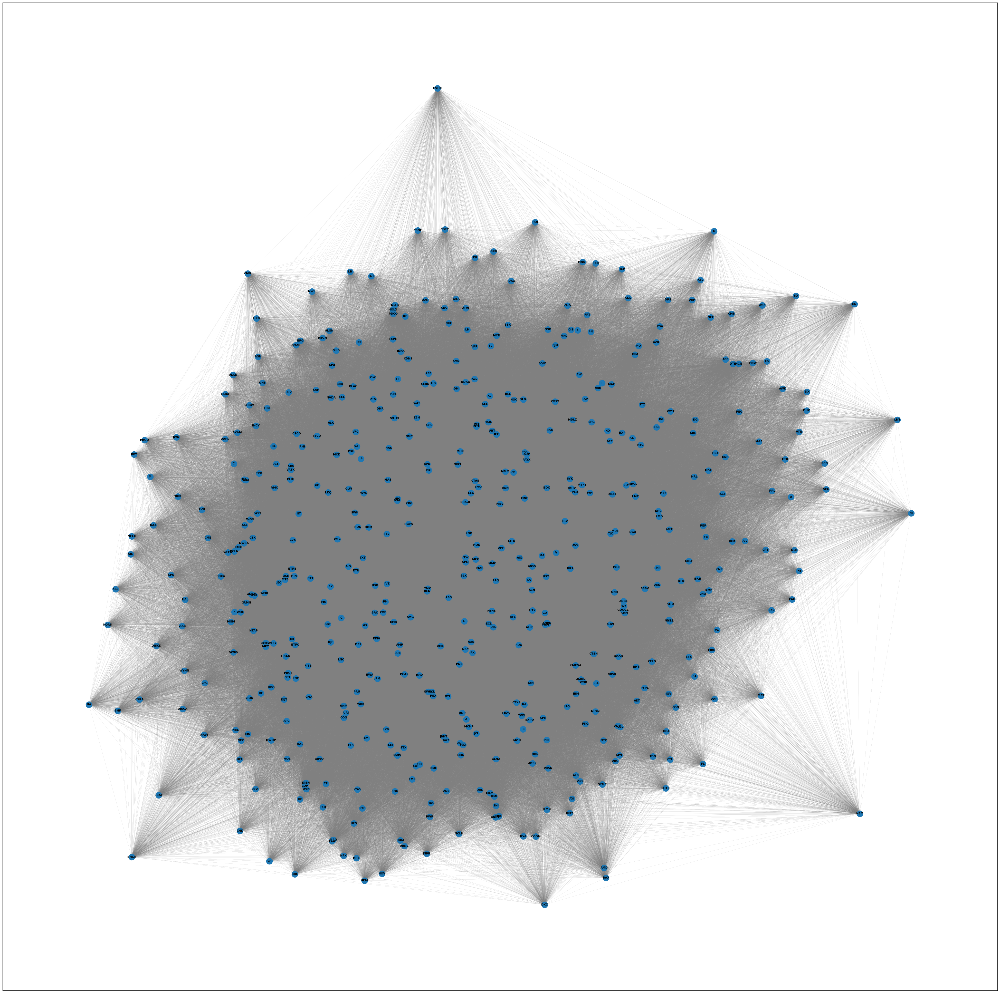

In [23]:
plt.figure(figsize=(50, 50))

pos = nx.spring_layout(G)
nx.draw_networkx(G, pos, with_labels=True, font_size=8, font_color="black", font_weight="bold", edge_color="gray", width=0.1)

plt.show()

In [24]:
nx.write_graphml(G, "pearson_correlation_full_graph.graphml")